## Modified normalized difference water index of Ethopian areas of interest images / bands from S3 bucket

#### Codes sourced from https://github.com/isikdogan/rivamap

In [ ]:
# installing necessary libraries
!pip install boto3 awscli
!pip install rasterio tifffile imagecodecs pyshp

     |████████████████████████████████| 3.3MB 4.7MB/s 
ERROR: awscli 1.18.130 has requirement botocore==1.17.53, but you'll have botocore 1.17.48 which is incompatible.
  Found existing installation: rsa 4.6
    Uninstalling rsa-4.6:
      Successfully uninstalled rsa-4.6
     |████████████████████████████████| 18.2MB 33.2MB/s 
     |████████████████████████████████| 17.9MB 203kB/s 
     |████████████████████████████████| 225kB 54.7MB/s 
  Created wheel for pyshp: filename=pyshp-2.1.0-cp36-none-any.whl size=32608 sha256=f8714b6200cf8d8384b0b9f19cdb70a6ad07ce62894b9fefd1a29d33e8a413e1
  Stored in directory: /root/.cache/pip/wheels/a6/0c/de/321b5192ad416b328975a2f0385f72c64db4656501eba7cc1a
Successfully built pyshp


In [ ]:
import os

# S3 credentials
aws_access_key_id = # key here
aws_secret_access_key = # key here
aws_default_region = # aws region here

os.environ['AWS_ACCESS_KEY_ID'] = aws_access_key_id
os.environ['AWS_SECRET_ACCESS_KEY'] = aws_secret_access_key
os.environ['AWS_DEFAULT_REGION'] = aws_default_region

In [ ]:
# Retrieving files from S3 bucket
!aws s3 cp 's3://omdenazzapp/aoi_10km_multiband/' 'aoi_10km_multiband'/  --recursive

download: s3://omdenazzapp/aoi_10km_multiband/Eth_aoi_pop (10)/download.B11.tif to aoi_10km_multiband/Eth_aoi_pop (10)/download.B11.tif
download: s3://omdenazzapp/aoi_10km_multiband/Eth_aoi_pop (11)/download.B11.tif to aoi_10km_multiband/Eth_aoi_pop (11)/download.B11.tif
download: s3://omdenazzapp/aoi_10km_multiband/Eth_aoi_pop (10)/download.B12.tif to aoi_10km_multiband/Eth_aoi_pop (10)/download.B12.tif
download: s3://omdenazzapp/aoi_10km_multiband/Eth_aoi_pop (11)/download.B12.tif to aoi_10km_multiband/Eth_aoi_pop (11)/download.B12.tif
download: s3://omdenazzapp/aoi_10km_multiband/Eth_aoi_pop (10)/download.B2.tif to aoi_10km_multiband/Eth_aoi_pop (10)/download.B2.tif
download: s3://omdenazzapp/aoi_10km_multiband/Eth_aoi_pop (10)/download.B3.tif to aoi_10km_multiband/Eth_aoi_pop (10)/download.B3.tif
download: s3://omdenazzapp/aoi_10km_multiband/Eth_aoi_pop (10)/download.B4.tif to aoi_10km_multiband/Eth_aoi_pop (10)/download.B4.tif
download: s3://omdenazzapp/aoi_10km_multiband/Eth_aoi_

In [ ]:
# Retrieving rivamap source code
!git clone https://github.com/isikdogan/rivamap.git

Cloning into 'rivamap'...
remote: Enumerating objects: 52, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (37/37), done.
remote: Total 421 (delta 24), reused 35 (delta 12), pack-reused 369
Receiving objects: 100% (421/421), 90.91 KiB | 8.26 MiB/s, done.
Resolving deltas: 100% (204/204), done.


In [ ]:
# Installing rivamap required dependencies
!sudo python /content/rivamap/setup.py install

running install
running bdist_egg
running egg_info
creating rivamap.egg-info
writing rivamap.egg-info/PKG-INFO
writing dependency_links to rivamap.egg-info/dependency_links.txt
writing requirements to rivamap.egg-info/requires.txt
writing top-level names to rivamap.egg-info/top_level.txt
writing manifest file 'rivamap.egg-info/SOURCES.txt'
package init file 'rivamap/__init__.py' not found (or not a regular file)
reading manifest file 'rivamap.egg-info/SOURCES.txt'
writing manifest file 'rivamap.egg-info/SOURCES.txt'
installing library code to build/bdist.linux-x86_64/egg
running install_lib
running build_py
creating build
creating build/lib
creating build/lib/rivamap
copying rivamap/setup.py -> build/lib/rivamap
creating build/bdist.linux-x86_64
creating build/bdist.linux-x86_64/egg
creating build/bdist.linux-x86_64/egg/rivamap
copying build/lib/rivamap/setup.py -> build/bdist.linux-x86_64/egg/rivamap
byte-compiling build/bdist.linux-x86_64/egg/rivamap/setup.py to setup.cpython-36.pyc


#### Import all modules:
- **preprocess:** includes utility functions such as contrast stretching, image type conversion, and water index computation  
- **singularity_index:** extracts curvilinear structures  
- **delineate:** delineate rivers and estimate their widths  
- **georef:** loads and saves georeferenced files  
- **visualization:** includes visualization functions  

In [ ]:
import cv2
import sys
sys.path.insert(0, '/content/rivamap/rivamap')
import preprocess
import singularity_index
#import delineate
import georef
import visualization

## Visualizing the two input band sample for generating outputs

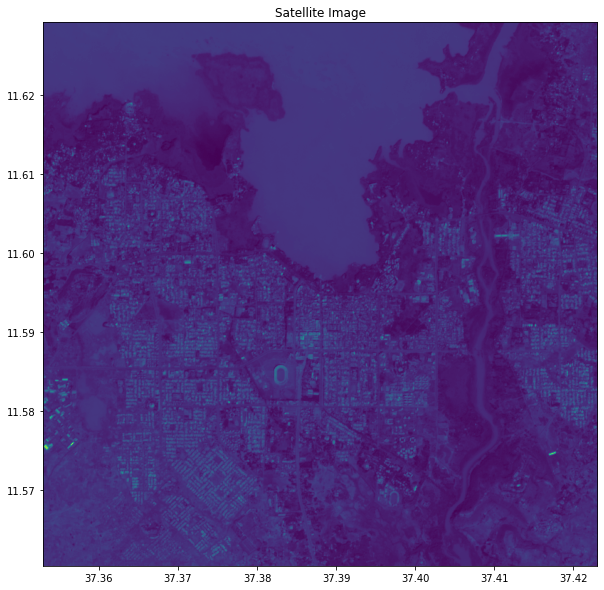

In [ ]:
# Green band (band 3)
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

satdat = rasterio.open('/content/aoi_10km_multiband/Eth_aoi_pop (2)/download.B3.tif')

fig, ax = plt.subplots(1, figsize=(12, 10))
show(satdat, ax=ax)
plt.title("Satellite Image")
plt.show()

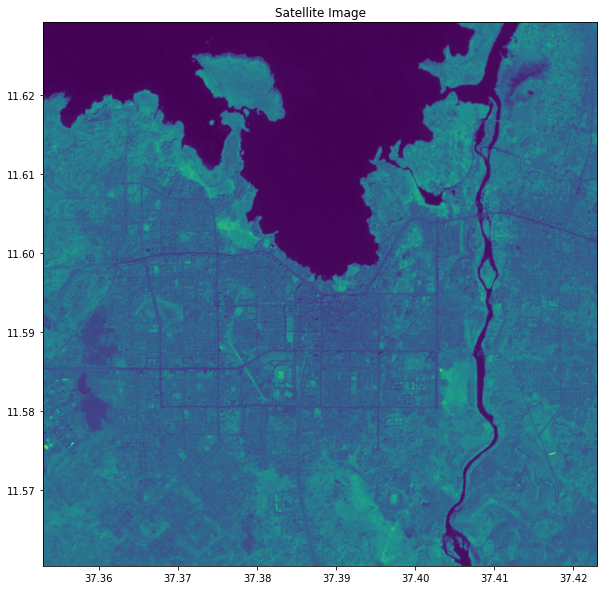

In [ ]:
# Near Infrared (NIR) band (band 8)
satdat = rasterio.open('/content/aoi_10km_multiband/Eth_aoi_pop (2)/download.B8.tif')

fig, ax = plt.subplots(1, figsize=(12, 10))
show(satdat, ax=ax)
plt.title("Satellite Image")
plt.show()

In [ ]:
# creating some helper functions 
# (Note: Some codes sourced from @Frank Merwerth's DeepWaterMap_Eth_aoi at 
# https://github.com/OmdenaAI/zzapp/blob/master/task_3_modelling/first_exploration/notebooks/DeepWaterMap_Eth_aoi.ipynb)
import tifffile as tiff
import numpy as np
import cv2

def create_dwm_array(image_path):
  '''
  Build array containing 6 bands that DeepWaterMap is using
  INPUT
  image_path        path to folder that contains tif-images for the single bands
  OUTPUT
  dwm_array         numpy array containing all 6 bands 
  '''

  red_band = tiff.imread(image_path + '/download.B4.tif')
  green_band = tiff.imread(image_path + '/download.B3.tif')
  blue_band = tiff.imread(image_path + '/download.B2.tif')
  NIR = tiff.imread(image_path + '/download.B8.tif')
  SWIR1 = tiff.imread(image_path + '/download.B11.tif')
  SWIR2 = tiff.imread(image_path + '/download.B12.tif')

  return np.dstack((blue_band, green_band, red_band, NIR, SWIR1, SWIR2))

def norm(band):
    band_min, band_max = band.min(), band.max()
    return ((band - band_min)/(band_max - band_min))
    


## PNG images of mndwi. Water pixels with bright white color

In [ ]:
def png_plot_predictions(min_img_id, max_img_id):
  '''
  Plots pairs of predicted mask an corresponding rgb image
  INPUT
  min_img_id, max_img_id    min, max ids of images to be predicted and plotted
                            via interfernce methods predicted masks are saved to disc
  OUTPUT
  None
  '''
  num_img = max_img_id - min_img_id +1 
  fig, axs = plt.subplots(num_img, 2, figsize = (20,6*num_img))

  for i in range(num_img):
    file_ext = ''
    if min_img_id + i > 1:
      file_ext = ' (' + str(min_img_id+i) +')'

    # green -- green band (e.g. Sentinel-2 band 3)
    B3 = cv2.imread("/content/aoi_10km_multiband/Eth_aoi_pop" + file_ext + "/download.B3.tif", cv2.IMREAD_UNCHANGED)

    # nir -- near infrared band (e.g. Sentinel-2 band 8)
    B6 = cv2.imread("/content/aoi_10km_multiband/Eth_aoi_pop" + file_ext + "/download.B8.tif", cv2.IMREAD_UNCHANGED)

    # Compute the modified normalized difference water index of the input and save the result if needed.
    # You can do this also on Google Earth Engine.
    I1 = preprocess.mndwi(B3, B6)
    cv2.imwrite("mndwi.png", cv2.normalize(I1, None, 0, 255, cv2.NORM_MINMAX))

    # Processing the input image rgb for display
    image_path = '/content/aoi_10km_multiband/Eth_aoi_pop' + file_ext
    image = create_dwm_array(image_path)
    im_org = np.clip(image, 300, 2800)
    img_rgb = np.dstack((norm(im_org[:,:,2]), norm(im_org[:,:,1]), norm(im_org[:,:,0])))

    # Processing the output image
    im_water = cv2.imread("/content/mndwi.png")
    
    water_ratio = len(im_water[im_water>220])/len(im_water[im_water>=0])
    axs[i,0].imshow(im_water, cmap = 'gray', interpolation = 'nearest')
    axs[i,0].set_title('Eth_aoi Image #: {}, WR = {:%}'.format(min_img_id+i, water_ratio))
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].imshow(img_rgb, cmap='gist_earth')
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])

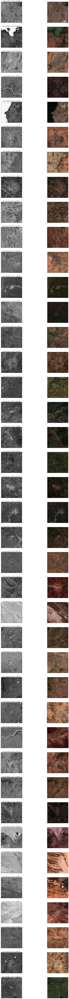

In [ ]:
# Processing and displaying the images
png_plot_predictions(1, 40)

## TIF images of mndwi. Water pixels with bright yellow color

In [ ]:
def plot_predictions(min_img_id, max_img_id):
  '''
  Plots pairs of predicted mask an corresponding rgb image
  INPUT
  min_img_id, max_img_id    min, max ids of images to be predicted and plotted
                            via interfernce methods predicted masks are saved to disc
  OUTPUT
  None
  '''
  num_img = max_img_id - min_img_id +1 
  fig, axs = plt.subplots(num_img, 2, figsize = (20,6*num_img))

  for i in range(num_img):
    file_ext = ''
    if min_img_id + i > 1:
      file_ext = ' (' + str(min_img_id+i) +')'

    # green -- green band (e.g. Sentinel-2 band 3)
    B3 = cv2.imread("/content/aoi_10km_multiband/Eth_aoi_pop" + file_ext + "/download.B3.tif", cv2.IMREAD_UNCHANGED)

    # nir -- near infrared band (e.g. Sentinel-2 band 8)
    B6 = cv2.imread("/content/aoi_10km_multiband/Eth_aoi_pop" + file_ext + "/download.B8.tif", cv2.IMREAD_UNCHANGED)

    # Compute the modified normalized difference water index of the input and save the result if needed.
    # You can do this also on Google Earth Engine.
    I1 = preprocess.mndwi(B3, B6)
    cv2.imwrite("mndwi.TIF", cv2.normalize(I1, None, 0, 255, cv2.NORM_MINMAX))

    # Processing the input image rgb for display
    image_path = '/content/aoi_10km_multiband/Eth_aoi_pop' + file_ext
    image = create_dwm_array(image_path)
    im_org = np.clip(image, 300, 2800)
    img_rgb = np.dstack((norm(im_org[:,:,2]), norm(im_org[:,:,1]), norm(im_org[:,:,0])))

    # Processing the output image
    im_water = rasterio.open('/content/mndwi.TIF')
    
    water_ratio = len(im_water.read(1)[im_water.read(1)>220])/len(im_water.read(1)[im_water.read(1)>=0])
    axs[i,0].imshow(im_water.read(1))
    axs[i,0].set_title('Eth_aoi Image #: {}, WR = {:%}'.format(min_img_id+i, water_ratio))
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].imshow(img_rgb, cmap='gist_earth')
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])

/usr/local/lib/python3.6/dist-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


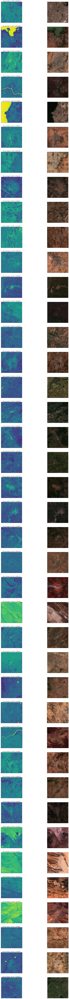

In [ ]:
# Processing and displaying the images
plot_predictions(1,40)